In [1]:
!nvidia-smi

Mon Aug 16 13:55:11 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
from torchvision import models, transforms

vgg = models.vgg19(pretrained=True).features

for param in vgg.parameters():
  param.requires_grad_(False)

In [3]:
for name, layer in vgg._modules.items():
  print(name," ----- ",layer)

0  -----  Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
1  -----  ReLU(inplace=True)
2  -----  Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
3  -----  ReLU(inplace=True)
4  -----  MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
5  -----  Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
6  -----  ReLU(inplace=True)
7  -----  Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
8  -----  ReLU(inplace=True)
9  -----  MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
10  -----  Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
11  -----  ReLU(inplace=True)
12  -----  Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
13  -----  ReLU(inplace=True)
14  -----  Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
15  -----  ReLU(inplace=True)
16  -----  Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
17

In [4]:
def get_features(image, model, layers=None):
  if layers is None:
    layers = {
        '0': 'conv1_1', 
        "5":"conv2_1",
        "10":"conv3_1",
        "19":"conv4_1",
        "21":"conv4_2",
        "28":"conv5_1"
    }
    features = {}
    x = image
    for name, layer in model._modules.items():
      x = layer(x)
      if name in layers:
        features[layers[name]] = x
    return features

In [5]:
# import resources
%matplotlib inline

from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.optim as optim
import requests

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [7]:
def load_image(image_path, maxSize=400, shape=None):
  if "http" in image_path:
    response = requests.get(image_path)
    image = Image.open(BytesIO(response.content)).convert('RGB')
  else:
    image = Image.open(image_path).convert('RGB')
  
  if max(image.size) > maxSize:
    size = maxSize
  else:
    size = max(image.size)

  if shape is not None:
    shape = size
  
  in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])
  image = in_transform(image)[:3,:,:].unsqueeze(0)
  return image

In [8]:
def gram_matrix(tensor):
  _, d, h, w = tensor.size()
  tensor = tensor.view(d, h * w)
  gram = torch.mm(tensor, tensor.t())
  return gram

In [9]:
# load in content and style image
content = load_image('content.jpg').to(device)
# Resize style to match content, makes code easier
style = load_image('style.jpg', shape=content.shape[-2:]).to(device)

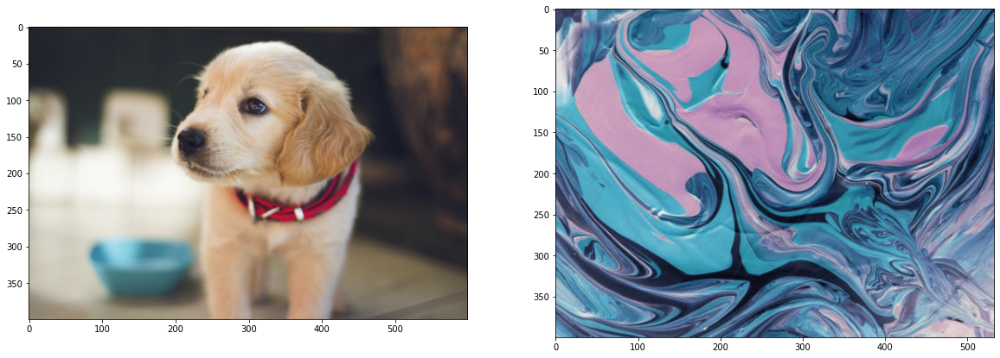

In [10]:
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image
    
# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
# content and style ims side-by-side
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(style))

In [11]:
content_features = get_features(content, vgg)
style_features = get_features(style, vgg)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [12]:
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}


In [13]:
target = content.clone().requires_grad_(True).to(device)

In [14]:
style_weights = {
    'conv1_1' : 1.,
    'conv2_1' : 1,
    'conv3_1' : 0.2,
    'conv4_1' : 0.2,
    'conv5_1' : 0.2
}

content_weight = 1
style_weight = 1e6

In [15]:
def contentloss(content, target):
    target_features = get_features(target, vgg)
    content_features = get_features(content, vgg)
    content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)    
    return content_loss

In [16]:
import cv2

def save(image, epoch):
  cv2.imwrite(f'/content/data/{epoch}.jpg', image)

Epochs: 100, Total loss:  188687728.0


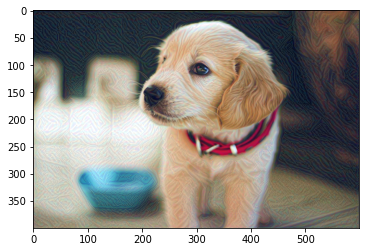

Epochs: 200, Total loss:  113497200.0


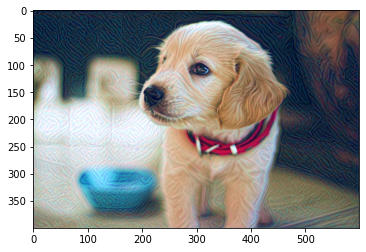

Epochs: 300, Total loss:  58879216.0


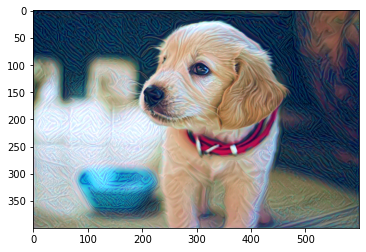

Epochs: 400, Total loss:  28725796.0


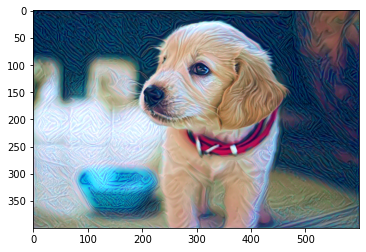

Epochs: 500, Total loss:  17576344.0


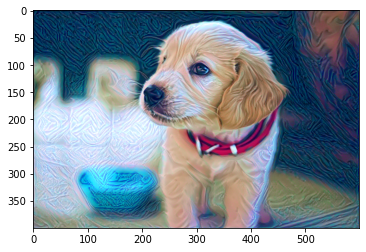

Epochs: 600, Total loss:  13402257.0


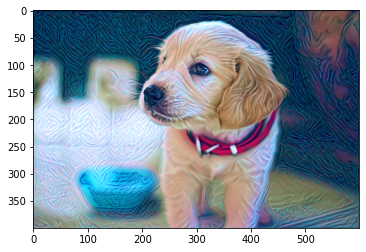

Epochs: 700, Total loss:  11097984.0


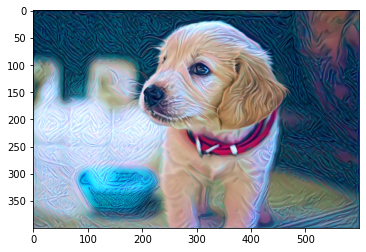

Epochs: 800, Total loss:  9507553.0


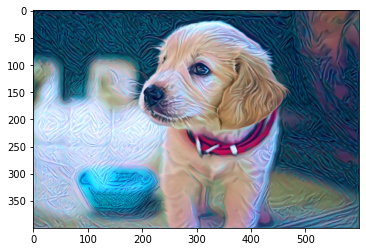

Epochs: 900, Total loss:  8303695.5


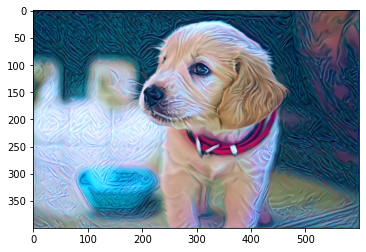

Epochs: 1000, Total loss:  7342119.0


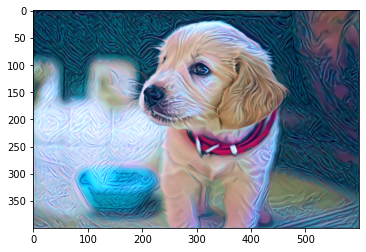

Epochs: 1100, Total loss:  6541299.0


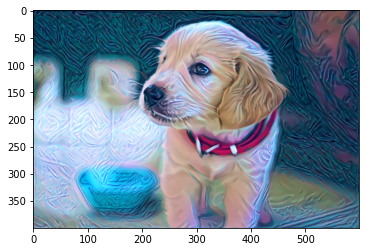

Epochs: 1200, Total loss:  5856319.5


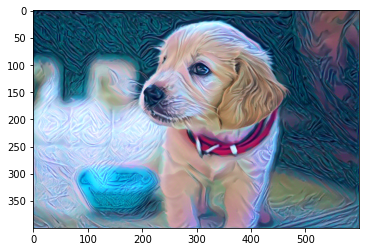

Epochs: 1300, Total loss:  5258083.5


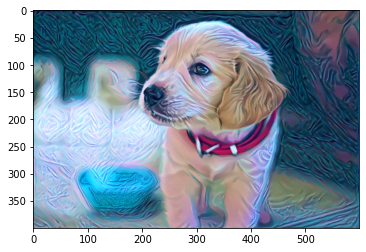

Epochs: 1400, Total loss:  4728808.0


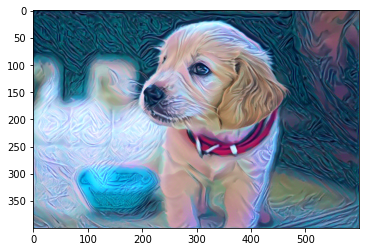

Epochs: 1500, Total loss:  4256832.0


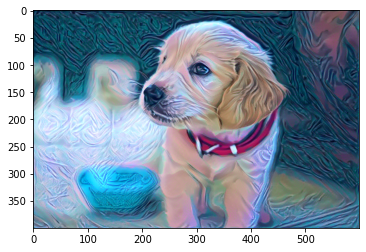

Epochs: 1600, Total loss:  3833818.5


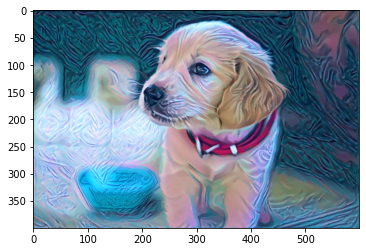

Epochs: 1700, Total loss:  3454028.5


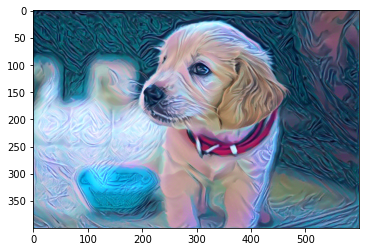

Epochs: 1800, Total loss:  3112668.0


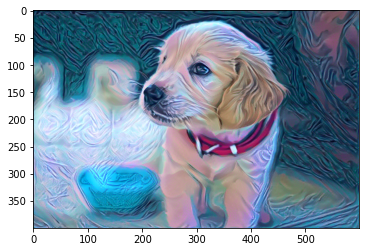

Epochs: 1900, Total loss:  2805520.25


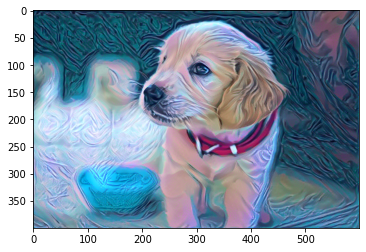

Epochs: 2000, Total loss:  2528989.5


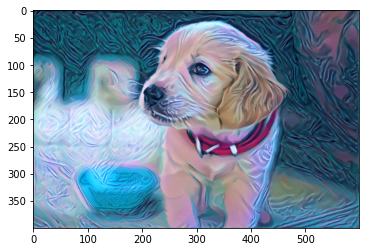

Epochs: 2100, Total loss:  2280616.0


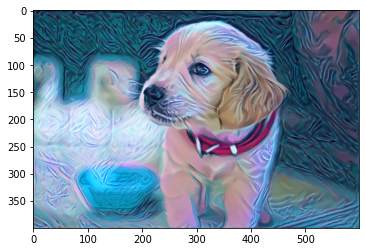

Epochs: 2200, Total loss:  2058004.875


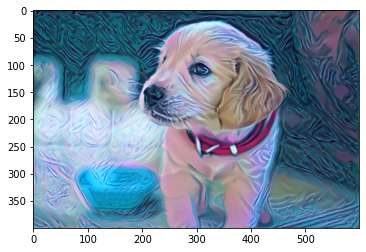

Epochs: 2300, Total loss:  1858789.0


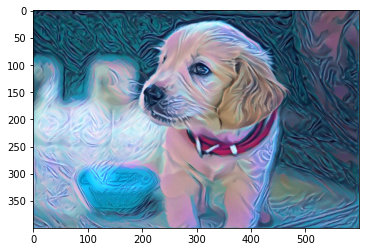

Epochs: 2400, Total loss:  1680716.375


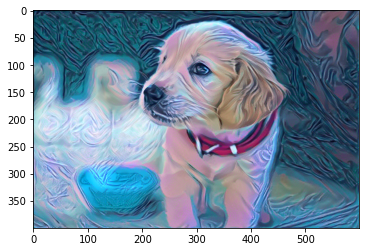

Epochs: 2500, Total loss:  1521726.875


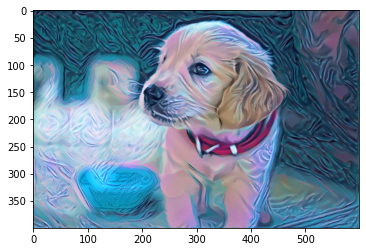

Epochs: 2600, Total loss:  1379804.25


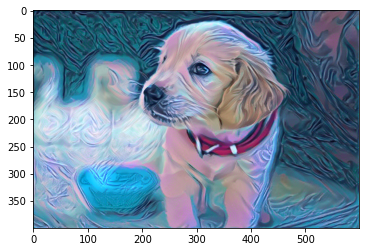

Epochs: 2700, Total loss:  1253100.5


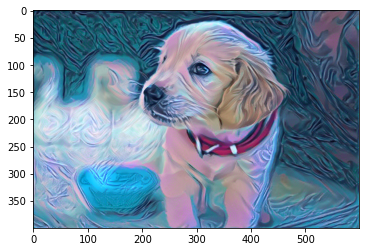

Epochs: 2800, Total loss:  1140171.5


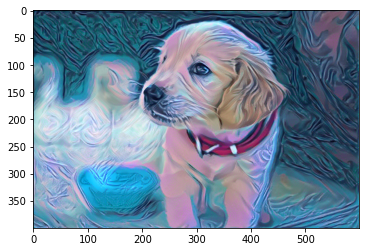

Epochs: 2900, Total loss:  1039443.1875


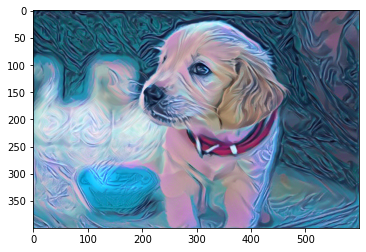

Epochs: 3000, Total loss:  949534.625


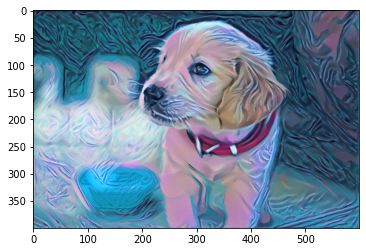

Epochs: 3100, Total loss:  869233.5


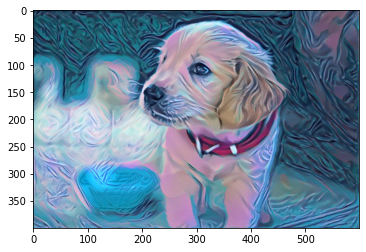

Epochs: 3200, Total loss:  797603.625


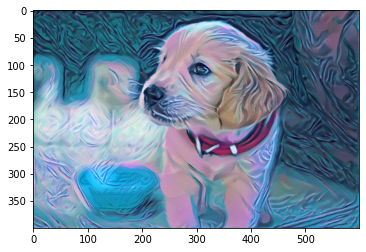

Epochs: 3300, Total loss:  733703.0


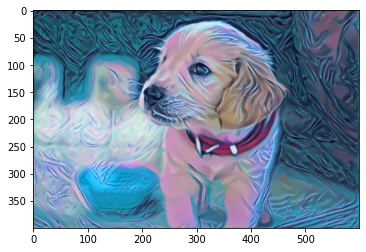

Epochs: 3400, Total loss:  676451.1875


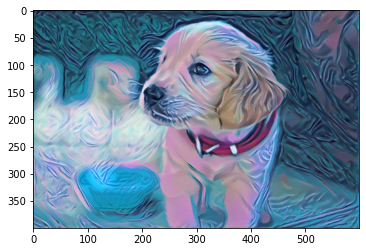

Epochs: 3500, Total loss:  625146.6875


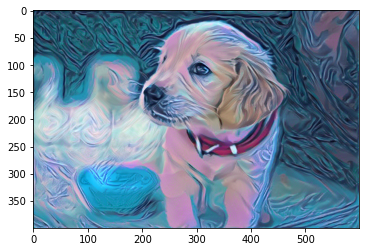

Epochs: 3600, Total loss:  579191.125


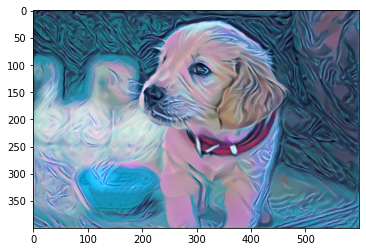

Epochs: 3700, Total loss:  537929.625


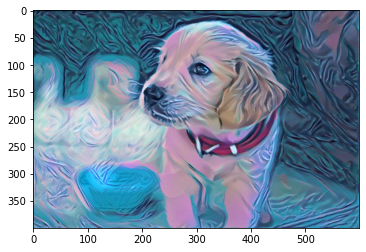

Epochs: 3800, Total loss:  500891.90625


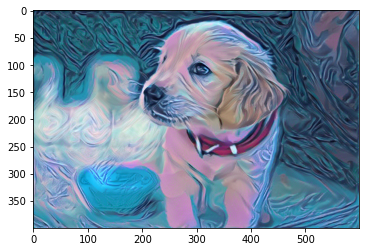

Epochs: 3900, Total loss:  467632.59375


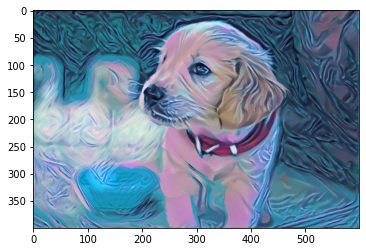

Epochs: 4000, Total loss:  437684.0625


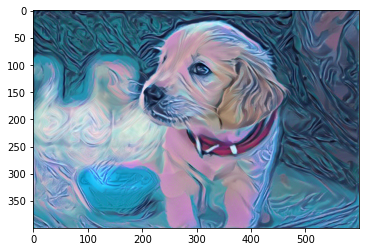

Epochs: 4100, Total loss:  410721.96875


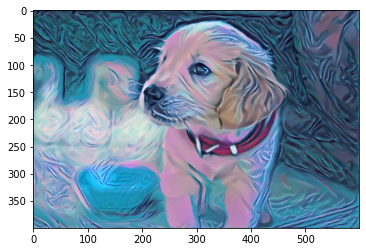

Epochs: 4200, Total loss:  386384.09375


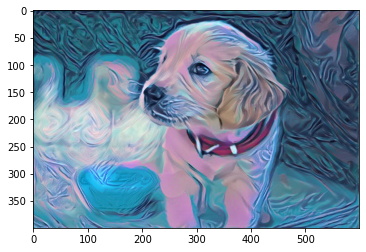

Epochs: 4300, Total loss:  364425.375


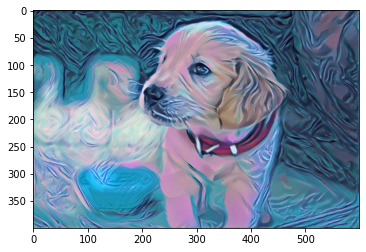

Epochs: 4400, Total loss:  344562.25


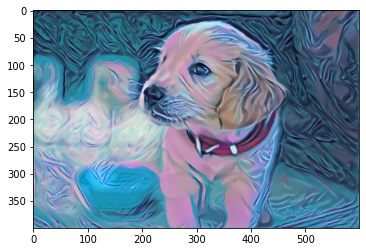

Epochs: 4500, Total loss:  326531.84375


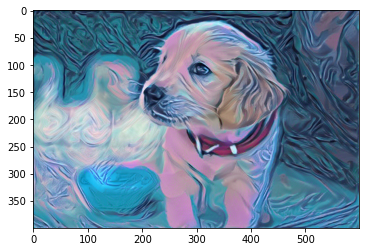

Epochs: 4600, Total loss:  310146.46875


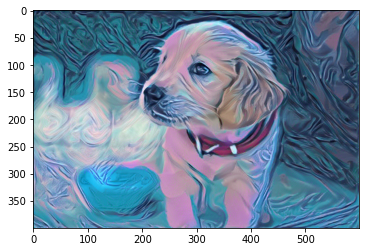

Epochs: 4700, Total loss:  295250.25


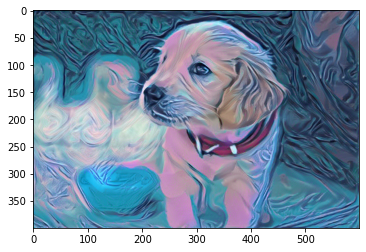

Epochs: 4800, Total loss:  281656.9375


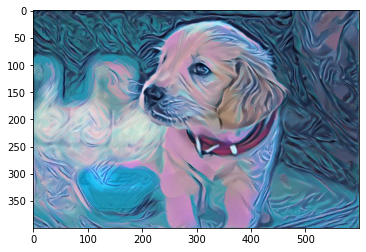

Epochs: 4900, Total loss:  269257.71875


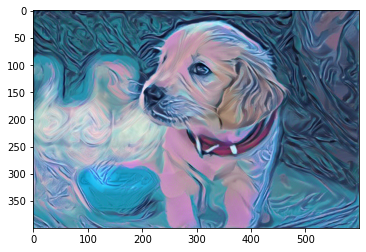

Epochs: 5000, Total loss:  257907.125


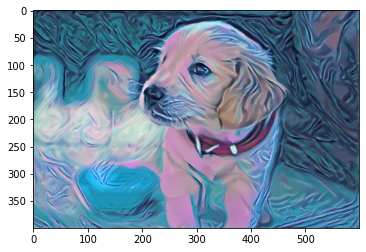

Epochs: 5100, Total loss:  247485.40625


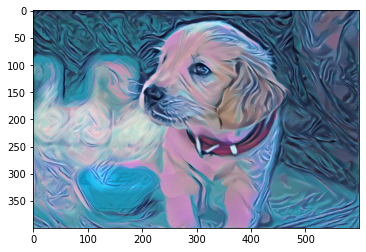

Epochs: 5200, Total loss:  237922.703125


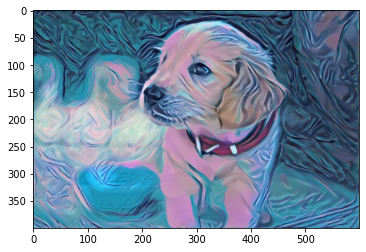

Epochs: 5300, Total loss:  229088.375


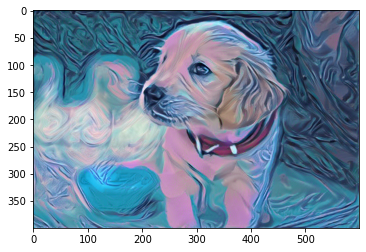

Epochs: 5400, Total loss:  220932.046875


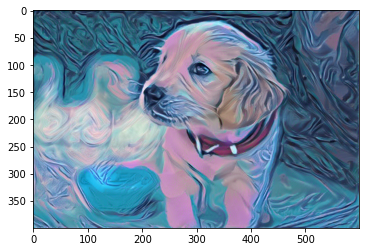

Epochs: 5500, Total loss:  213368.4375


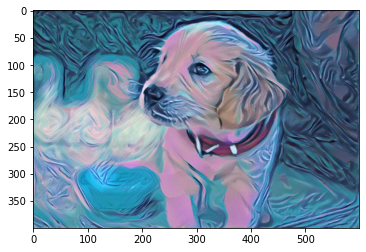

Epochs: 5600, Total loss:  206332.6875


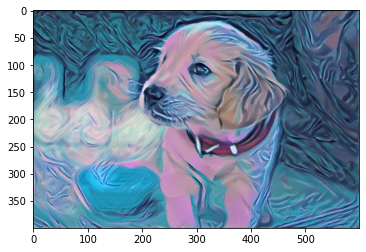

Epochs: 5700, Total loss:  199791.03125


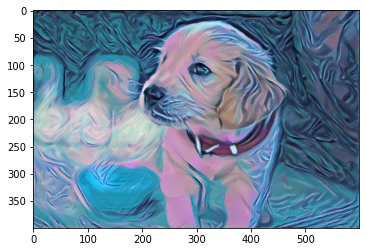

Epochs: 5800, Total loss:  193653.703125


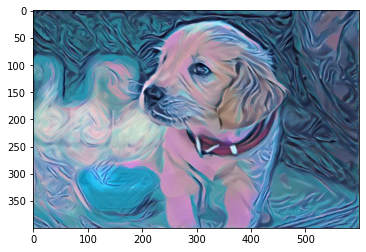

Epochs: 5900, Total loss:  187922.078125


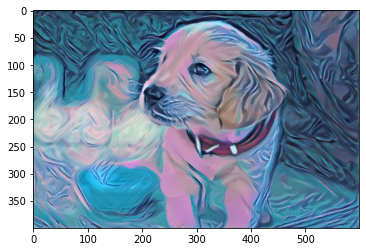

Epochs: 6000, Total loss:  182533.703125


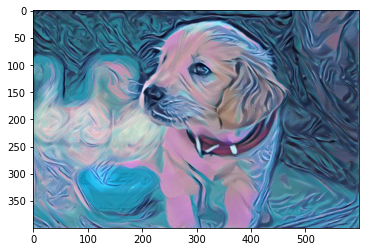

Epochs: 6100, Total loss:  177472.4375


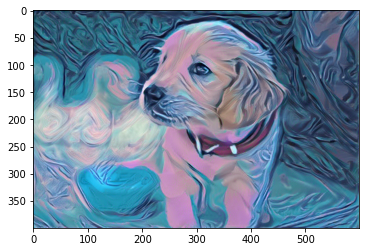

Epochs: 6200, Total loss:  172698.578125


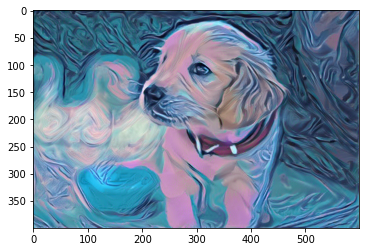

Epochs: 6300, Total loss:  168198.140625


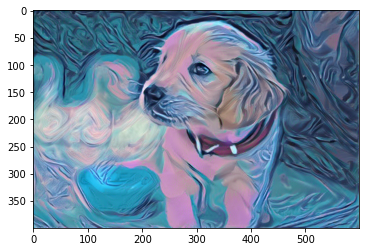

Epochs: 6400, Total loss:  163940.296875


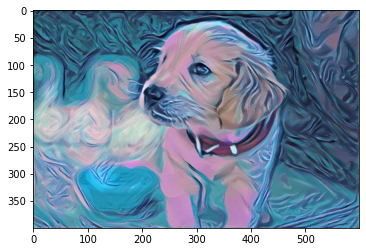

Epochs: 6500, Total loss:  159921.03125


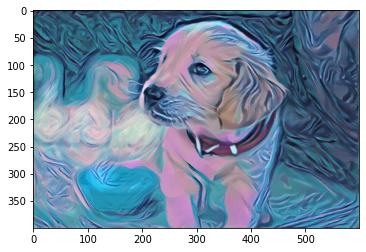

Epochs: 6600, Total loss:  156111.28125


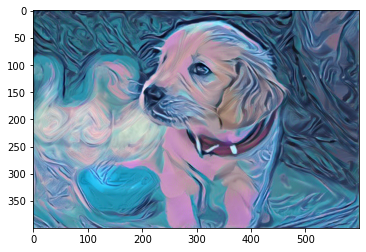

Epochs: 6700, Total loss:  152496.0625


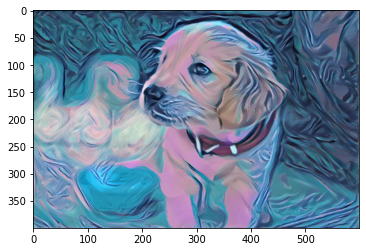

Epochs: 6800, Total loss:  149082.21875


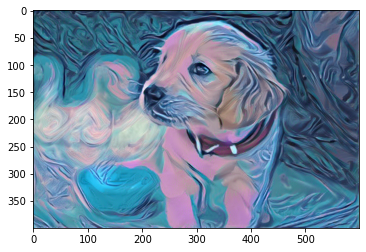

Epochs: 6900, Total loss:  145834.046875


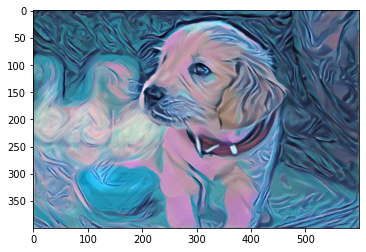

Epochs: 7000, Total loss:  142739.53125


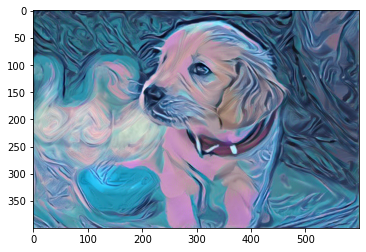

Epochs: 7100, Total loss:  139781.78125


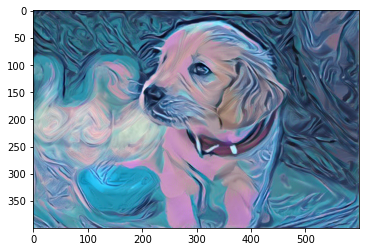

Epochs: 7200, Total loss:  136959.671875


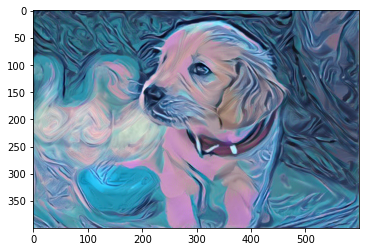

Epochs: 7300, Total loss:  134383.234375


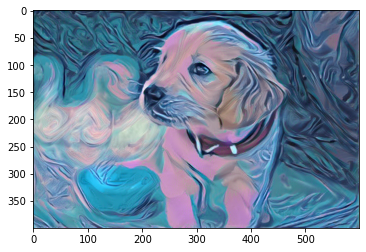

Epochs: 7400, Total loss:  131673.171875


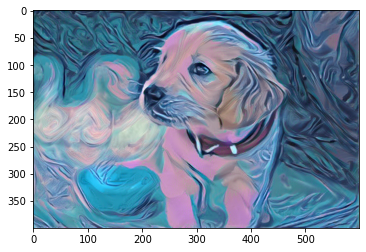

Epochs: 7500, Total loss:  129453.2109375


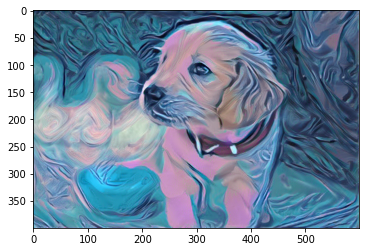

Epochs: 7600, Total loss:  126989.7109375


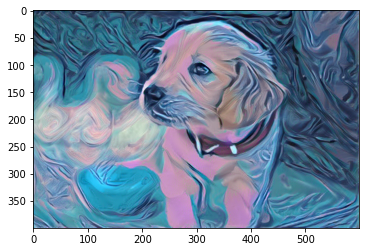

Epochs: 7700, Total loss:  125012.625


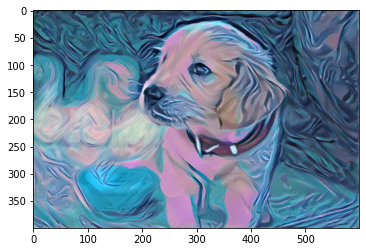

Epochs: 7800, Total loss:  122727.015625


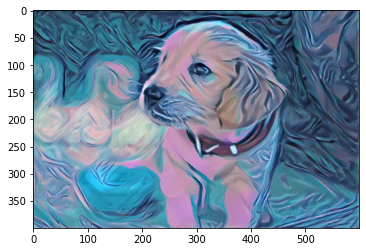

Epochs: 7900, Total loss:  120739.5625


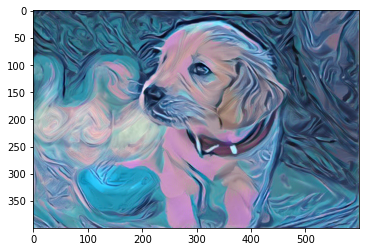

Epochs: 8000, Total loss:  118850.4140625


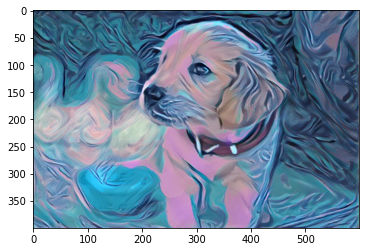

Epochs: 8100, Total loss:  117412.6796875


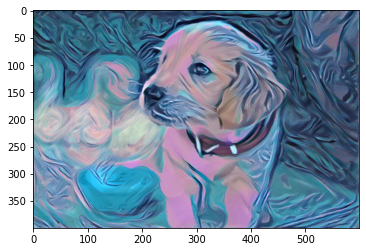

Epochs: 8200, Total loss:  115434.2890625


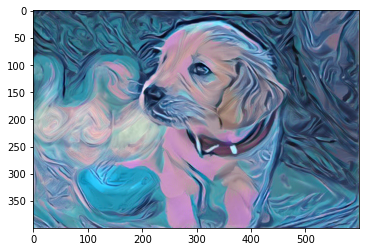

Epochs: 8300, Total loss:  114061.71875


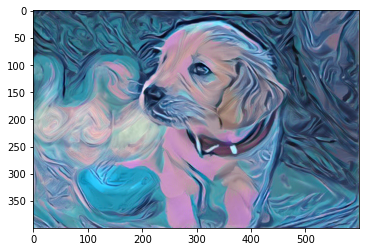

Epochs: 8400, Total loss:  112275.7421875


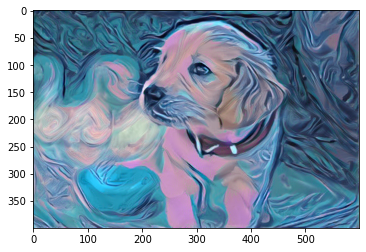

Epochs: 8500, Total loss:  110895.6953125


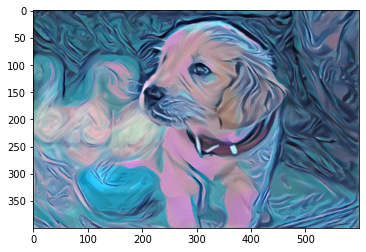

Epochs: 8600, Total loss:  109529.5859375


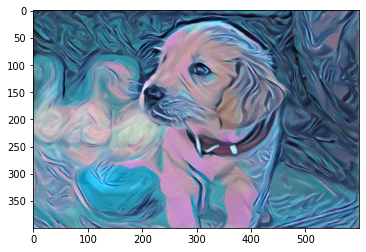

Epochs: 8700, Total loss:  109013.3046875


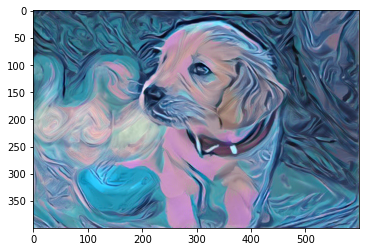

Epochs: 8800, Total loss:  107181.75


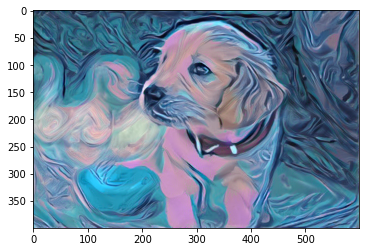

Epochs: 8900, Total loss:  105915.4765625


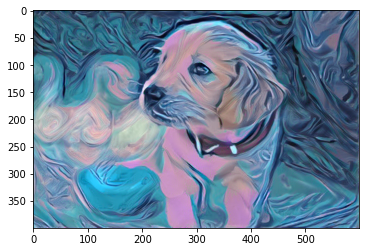

Epochs: 9000, Total loss:  104702.421875


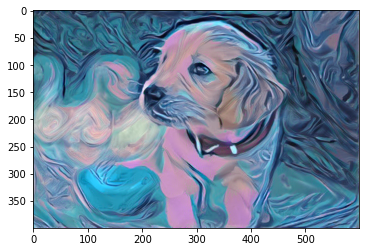

Epochs: 9100, Total loss:  104586.546875


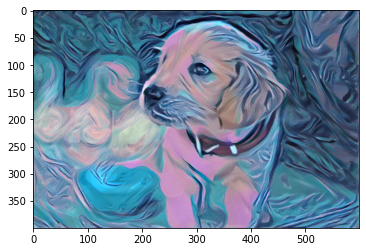

Epochs: 9200, Total loss:  102721.5546875


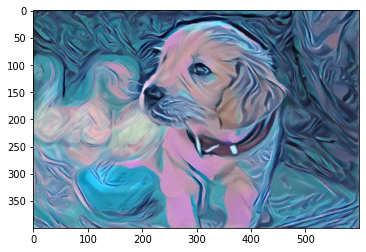

Epochs: 9300, Total loss:  102306.4296875


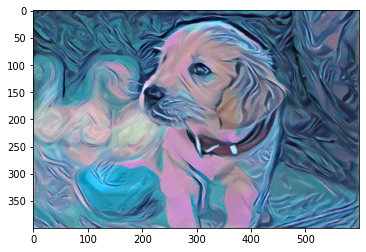

Epochs: 9400, Total loss:  100614.7421875


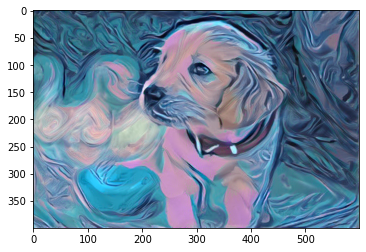

Epochs: 9500, Total loss:  99745.0703125


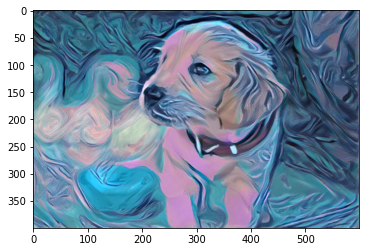

Epochs: 9600, Total loss:  99553.2890625


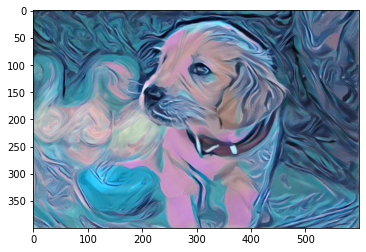

Epochs: 9700, Total loss:  98242.78125


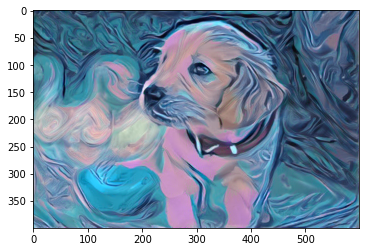

Epochs: 9800, Total loss:  97538.015625


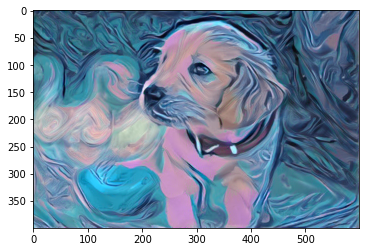

Epochs: 9900, Total loss:  97336.1640625


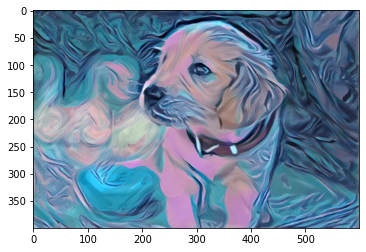

Epochs: 10000, Total loss:  95972.28125


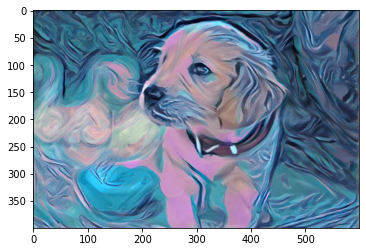

In [17]:
show_every = 100
optimizer = optim.Adam([target], lr=0.003)


steps = 10000 
for ii in range(1, steps+1):
    target_features = get_features(target, vgg)
    content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
    style_loss = 0
    for layer in style_weights:
        target_feature = target_features[layer]
        target_gram = gram_matrix(target_feature)
        _, d, h, w = target_feature.shape
        style_gram = style_grams[layer]
        layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
        style_loss += layer_style_loss / (d * h * w)
        
    total_loss = content_weight * content_loss + style_weight * style_loss
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    if  ii % show_every == 0:
        print('Epochs: {}, Total loss:  {}'.format(ii, total_loss.item()))
        plt.imshow(im_convert(target))
        plt.show()

In [18]:
save(im_convert(target), 10000)